In [22]:
%matplotlib inline

import os, sys, csv
import numpy as np
import pandas as pd
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns; sns.set(style="ticks", color_codes=True)

In [23]:
base_path = '../data/data-science-london-scikit-learn'

In [24]:
!ls ../data/data-science-london-scikit-learn 

test.csv  train.csv  trainLabels.csv


In [37]:
train = pd.read_csv(os.path.join(base_path, 'train.csv'), header=None)
test = pd.read_csv(os.path.join(base_path, 'test.csv'), header=None)
label = pd.read_csv(os.path.join(base_path, 'trainLabels.csv'), header=None)
print(train.shape)
print(label.shape)
print(test.shape)

(1000, 40)
(1000, 1)
(9000, 40)


In [38]:
idx = np.random.permutation(train.index)

train = train.reindex(idx)
label = label.reindex(idx)

In [39]:
for col in train.columns:
    train[col] = ((train[col] + 20) * 10) ** 2

In [40]:
for col in test.columns:
    test[col] = ((test[col] + 20) * 10 ) ** 2

In [41]:
X_train, X_test, y_train, y_test = train_test_split(train, label, random_state = 7, test_size = 0.2)
X, X_t, y, y_t = train_test_split(X_train, y_train, random_state = 7, test_size = 0.2)

In [31]:
X.describe()

,0,1,2,3,4,5,6,7,8,9,...,30,31,32,33,34,35,36,37,38,39
count,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000,...,640.000000,6.400000e+02,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000,640.000000
mean,98.563364,98.473279,95.420337,87.881465,2127.812336,101.026903,477.721449,479.130135,97.072335,104.131449,...,95.329283,1.001885e+02,533.114780,104.317586,437.692744,101.831802,530.331175,94.822064,485.434156,460.904733
std,143.389956,137.202449,123.315283,120.556776,3332.493319,131.496602,666.724545,680.177706,122.943725,155.926927,...,132.484589,1.347428e+02,734.600241,151.049388,608.892729,146.707809,702.683239,136.313039,734.799078,658.159874
min,0.004496,0.000006,0.000003,0.000085,0.000370,0.000004,0.002974,0.003125,0.000989,0.000011,...,0.000255,4.871495e-07,0.039109,0.000025,0.002901,0.000450,0.000082,0.002482,0.002855,0.006014
25%,9.764388,9.712462,11.535837,8.448256,180.311485,12.430908,55.949866,48.241284,10.844097,10.313020,...,11.850097,1.134614e+01,57.873314,9.944395,47.227265,10.872706,57.513971,10.428076,49.631090,45.241305
50%,44.502570,44.079124,46.916995,38.248678,806.800502,54.060010,207.624712,226.221236,48.080671,44.954443,...,45.324428,4.948303e+01,272.264949,41.767484,210.111035,45.043978,245.042715,46.966542,202.143418,195.052716
75%,128.248950,133.806928,125.341596,123.114184,2615.432034,134.082966,617.930298,633.487008,144.774178,136.741018,...,122.702843,1.291666e+02,739.499805,140.389758,565.417504,129.567657,766.836177,122.815941,603.021900,642.456776
max,1106.391247,900.988425,648.469545,774.403398,30854.132760,962.859233,5219.716621,4236.817769,750.449010,1536.189828,...,974.185570,8.827581e+02,5602.427201,1124.683774,4416.850867,958.761584,4339.916200,1219.788861,6483.023349,6082.574412


In [37]:
dataf = train
dataf['y'] = label

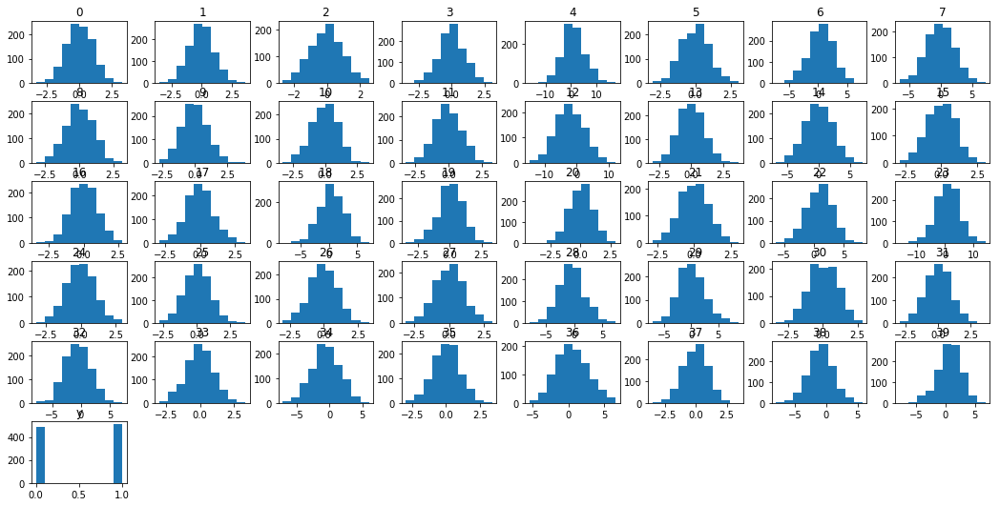

In [41]:
dataf.hist(bins=10, figsize=(18,12), grid=False, sharex=False, layout=(8,8));

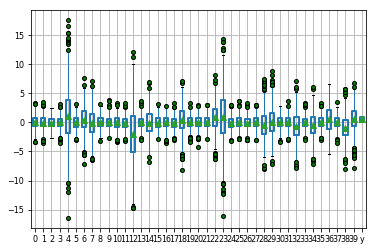

In [42]:
dataf.plot(fontsize=8, kind='box', boxprops={'linewidth': 2, 'markerfacecolor': 'green'},
           flierprops=dict(marker='o', markerfacecolor='green', markersize=4, linestyle='none'),
           showmeans=True, grid=True)

In [45]:
sns.pairplot(dataf, hue="y")

In [51]:
# eval_metrics can selecy rmse, logloss, error, auc, merror, mlogloss or custom define
eval_set =  [(X_test, y_test)]
model = XGBClassifier(max_depth=5, learning_rate=0.1, n_estimators=200, booster='gbtree',
                     gamma=0,reg_alpha=0, reg_lambda=0)
model.fit(X_train, y_train, eval_metric="logloss", early_stopping_rounds=30,
          eval_set=eval_set, verbose=True)

[0]	validation_0-logloss:0.643995
Will train until validation_0-logloss hasn't improved in 30 rounds.
[1]	validation_0-logloss:0.604775
[2]	validation_0-logloss:0.565055
[3]	validation_0-logloss:0.526952
[4]	validation_0-logloss:0.498258
[5]	validation_0-logloss:0.474573
[6]	validation_0-logloss:0.45325
[7]	validation_0-logloss:0.429555
[8]	validation_0-logloss:0.418163
[9]	validation_0-logloss:0.403225
[10]	validation_0-logloss:0.389493
[11]	validation_0-logloss:0.374971
[12]	validation_0-logloss:0.362623
[13]	validation_0-logloss:0.353681
[14]	validation_0-logloss:0.345582
[15]	validation_0-logloss:0.336829
[16]	validation_0-logloss:0.331872
[17]	validation_0-logloss:0.323157
[18]	validation_0-logloss:0.315816
[19]	validation_0-logloss:0.308719
[20]	validation_0-logloss:0.301173
[21]	validation_0-logloss:0.297015
[22]	validation_0-logloss:0.296493
[23]	validation_0-logloss:0.29526
[24]	validation_0-logloss:0.292422
[25]	validation_0-logloss:0.290014
[26]	validation_0-logloss:0.286445

/net/account/pixuser/wayne/python-env/p362/lib/python3.6/site-packages/sklearn/preprocessing/label.py:95: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/net/account/pixuser/wayne/python-env/p362/lib/python3.6/site-packages/sklearn/preprocessing/label.py:128: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[38]	validation_0-logloss:0.268583
[39]	validation_0-logloss:0.263536
[40]	validation_0-logloss:0.262193
[41]	validation_0-logloss:0.258865
[42]	validation_0-logloss:0.257464
[43]	validation_0-logloss:0.256415
[44]	validation_0-logloss:0.255325
[45]	validation_0-logloss:0.251302
[46]	validation_0-logloss:0.249988
[47]	validation_0-logloss:0.247658
[48]	validation_0-logloss:0.247337
[49]	validation_0-logloss:0.246191
[50]	validation_0-logloss:0.246008
[51]	validation_0-logloss:0.24503
[52]	validation_0-logloss:0.242689
[53]	validation_0-logloss:0.241927
[54]	validation_0-logloss:0.240502
[55]	validation_0-logloss:0.240042
[56]	validation_0-logloss:0.238122
[57]	validation_0-logloss:0.237557
[58]	validation_0-logloss:0.237715
[59]	validation_0-logloss:0.237003
[60]	validation_0-logloss:0.235574
[61]	validation_0-logloss:0.234289
[62]	validation_0-logloss:0.233664
[63]	validation_0-logloss:0.233253
[64]	validation_0-logloss:0.232749
[65]	validation_0-logloss:0.231551
[66]	validation_0-log

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=5, min_child_weight=1, missing=None, n_estimators=200,
       n_jobs=1, nthread=None, objective='binary:logistic', random_state=0,
       reg_alpha=0, reg_lambda=0, scale_pos_weight=1, seed=None,
       silent=True, subsample=1)

In [52]:
# we use model.predict to get the label
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 91.50%


/net/account/pixuser/wayne/python-env/p362/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


In [53]:
print(model.feature_importances_)

[0.01115619 0.01419878 0.02281947 0.01166329 0.03853955 0.01064909
 0.05476673 0.03955375 0.01267749 0.01419878 0.00963489 0.01572008
 0.04107505 0.01166329 0.06186613 0.01825558 0.01064909 0.01115619
 0.05679513 0.00507099 0.02028398 0.01673428 0.03042596 0.01115619
 0.01217039 0.00760649 0.00862069 0.01166329 0.04208925 0.05780933
 0.01318458 0.00963489 0.04259635 0.01470588 0.05628803 0.00507099
 0.07150102 0.01825558 0.01876268 0.05933063]


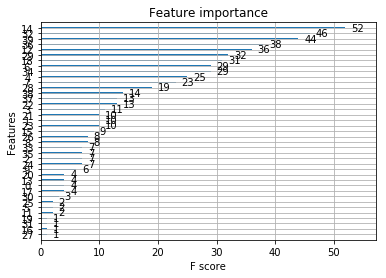

In [27]:
# import the plot_importance function to visualize the feature importance
from xgboost import plot_importance
plot_importance(model)
plt.show()

```
Id,Solution
1,0
2,1
3,1
...
9000,0

```

In [54]:
pred = model.predict(test)

/net/account/pixuser/wayne/python-env/p362/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


In [55]:
result = pd.DataFrame(np.column_stack([np.arange(pred.shape[0]) + 1, pred]), columns=['Id', 'Solution'])

In [56]:
result.to_csv('scikit-learn-practice-2.csv', index=False)

In [47]:
result

,Id,Solution
0,1,1
1,2,0
2,3,1
3,4,0
4,5,0
5,6,0
6,7,0
7,8,1
8,9,0
9,10,0
